In [23]:
# this is program to segment the image and count the number of objects in the image

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from edgeDetector import *
from morphological import *
from processing_list import *

# import opencv
import cv2


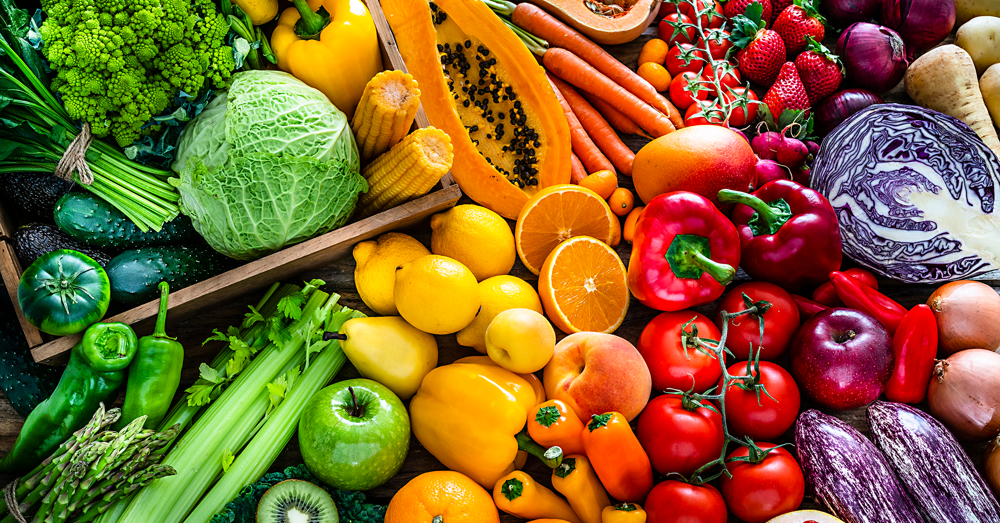

In [11]:
img = Image.open('uas/Image1.jpg')
img = img.convert('RGB')

img 

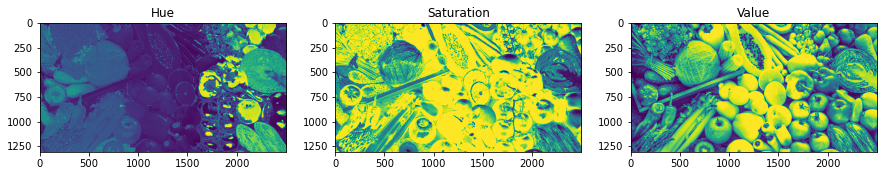

In [19]:
# convert rgb to hsv and split the image into 3 channels
hsv = img.convert('HSV')
h,s,v = hsv.split()

# plot the h,s,v channels to see the image
plt.figure(figsize=(15,15))
plt.subplot(1,3,1)
plt.imshow(h)
# title of the plot
plt.title('Hue')
plt.subplot(1,3,2)
plt.imshow(s)
plt.title('Saturation')
plt.subplot(1,3,3)
plt.imshow(v)
plt.title('Value')
plt.show()

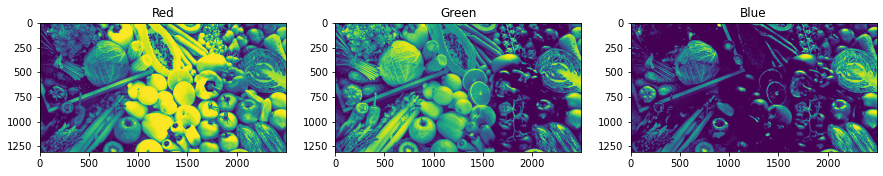

In [20]:
# split the r g b channels
r,g,b = img.split()

# plot the r g b channels to see the image
plt.figure(figsize=(15,15))
plt.subplot(1,3,1)
plt.imshow(r)
# title of the plot
plt.title('Red')
plt.subplot(1,3,2)
plt.imshow(g)
plt.title('Green')
plt.subplot(1,3,3)
plt.imshow(b)
plt.title('Blue')
plt.show()


In [41]:
# get range of color in hsv
# get the range of green color in hsv
lower_green = np.array([40,40,40])
upper_green = np.array([70,255,255])

# get the range of dark green color in hsv
lower_darkgreen = np.array([25,40,40])


# get the range of red color in hsv
lower_red = np.array([0,50,50])
upper_red = np.array([10,255,255])

# get the range of blue color in hsv
lower_blue = np.array([110,50,50])
upper_blue = np.array([130,255,255])

# get the range of yellow color in hsv
lower_yellow = np.array([20,100,100])
upper_yellow = np.array([30,255,255])

# get the range of orange color in hsv
lower_orange = np.array([10,100,100])
upper_orange = np.array([20,255,255])

# get the range of purple color in hsv
lower_purple = np.array([130,50,50])
upper_purple = np.array([150,255,255])

# get the range of brown color in hsv
lower_brown = np.array([5,50,50])
upper_brown = np.array([15,255,255])


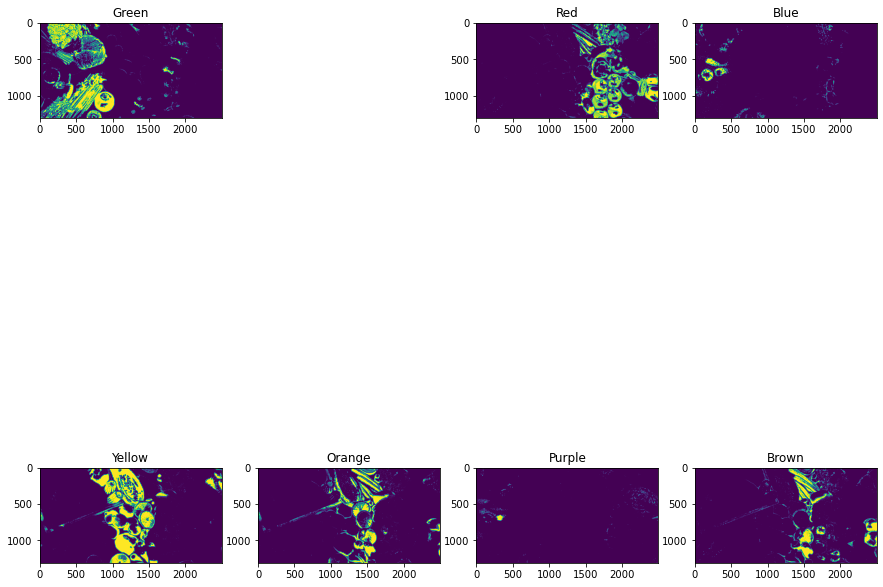

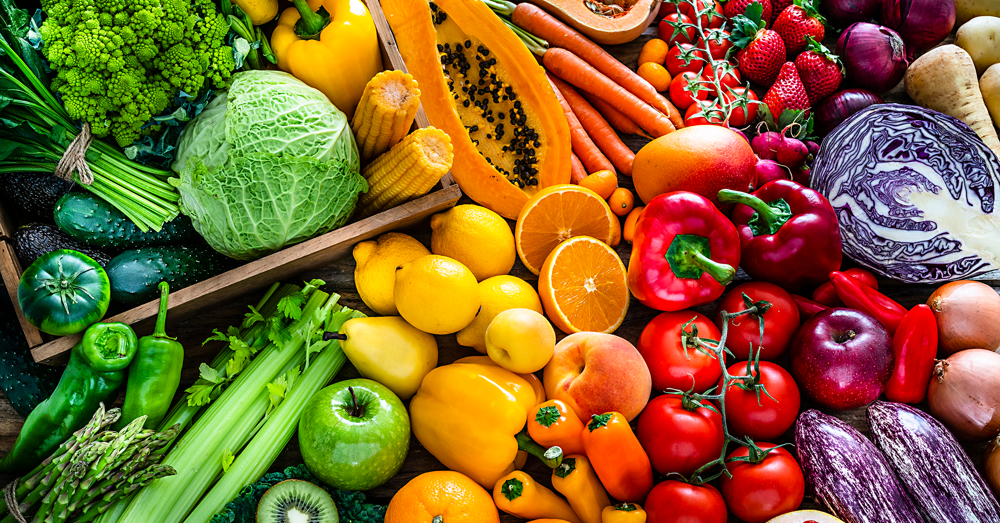

In [47]:
# make a mask for each color
mask_green = cv2.inRange(np.array(hsv), lower_green, upper_green)
mask_red = cv2.inRange(np.array(hsv), lower_red, upper_red)
mask_blue = cv2.inRange(np.array(hsv), lower_blue, upper_blue)
mask_yellow = cv2.inRange(np.array(hsv), lower_yellow, upper_yellow)
mask_orange = cv2.inRange(np.array(hsv), lower_orange, upper_orange)
mask_purple = cv2.inRange(np.array(hsv), lower_purple, upper_purple)
mask_brown = cv2.inRange(np.array(hsv), lower_brown, upper_brown)

# plot the mask of each color
plt.figure(figsize=(15,15))
plt.subplot(2,4,1)
plt.imshow(mask_green)
# title of the plot
plt.title('Green')
plt.subplot(2,4,3)
plt.imshow(mask_red)
plt.title('Red')
plt.subplot(2,4,4)
plt.imshow(mask_blue)
plt.title('Blue')
plt.subplot(2,4,5)
plt.imshow(mask_yellow)
plt.title('Yellow')
plt.subplot(2,4,6)
plt.imshow(mask_orange)
plt.title('Orange')
plt.subplot(2,4,7)
plt.imshow(mask_purple)
plt.title('Purple')
plt.subplot(2,4,8)
plt.imshow(mask_brown)
plt.title('Brown')
plt.show()

img


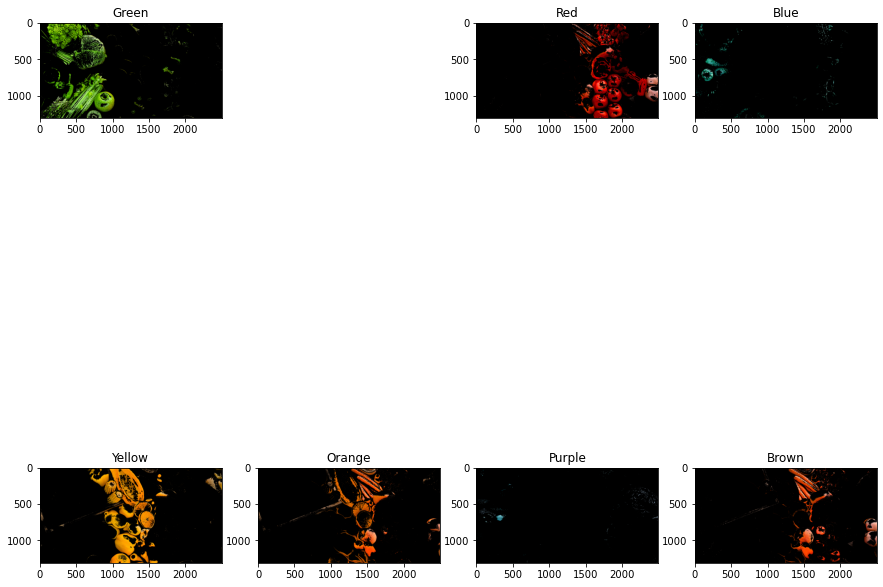

In [50]:
# use the mask to get the image
res_green = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_green)
res_red = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_red)
res_blue = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_blue)
res_yellow = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_yellow)
res_orange = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_orange)
res_purple = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_purple)
res_brown = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_brown)

# plot the image of each color
plt.figure(figsize=(15,15))
plt.subplot(2,4,1)
plt.imshow(res_green)
# title of the plot
plt.title('Green')
plt.subplot(2,4,3)
plt.imshow(res_red)
plt.title('Red')
plt.subplot(2,4,4)
plt.imshow(res_blue)
plt.title('Blue')
plt.subplot(2,4,5)
plt.imshow(res_yellow)
plt.title('Yellow')
plt.subplot(2,4,6)
plt.imshow(res_orange)
plt.title('Orange')
plt.subplot(2,4,7)
plt.imshow(res_purple)
plt.title('Purple')
plt.subplot(2,4,8)
plt.imshow(res_brown)
plt.title('Brown')
plt.show()


In [ ]:
def getPixelColor(img, x, y):
    # get the pixel color
    pixel = img.load()
    


error: OpenCV(4.7.0) :-1: error: (-5:Bad argument) in function 'drawContours'
> Overload resolution failed:
>  - image is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'image'


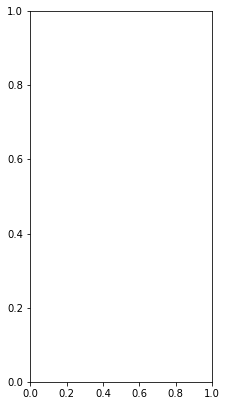

In [52]:
# make funtion to rectange the color
def rectangle_color(img, color):
    # convert the image to hsv
    hsv = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2HSV)
    # get the range of color in hsv
    lower_color = np.array(color[0])
    upper_color = np.array(color[1])
    # make a mask for each color
    mask_color = cv2.inRange(np.array(hsv), lower_color, upper_color)
    # use the mask to get the image
    res_color = cv2.bitwise_and(np.array(img),np.array(img), mask= mask_color)
    # get the contours of the image
    contours, hierarchy = cv2.findContours(mask_color, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # draw the contours
    cv2.drawContours(img, contours, -1, (0,255,0), 3)
    return img

# make a list of colors
colors = [[lower_green, upper_green], [lower_red, upper_red], [lower_blue, upper_blue], [lower_yellow, upper_yellow], [lower_orange, upper_orange], [lower_purple, upper_purple], [lower_brown, upper_brown]]

# make a list of names of colors
names = ['Green', 'Red', 'Blue', 'Yellow', 'Orange', 'Purple', 'Brown']

# plot the image of each color
plt.figure(figsize=(15,15))
for i in range(len(colors)):
    plt.subplot(2,4,i+1)
    plt.imshow(rectangle_color(img, colors[i]))
    # title of the plot
    plt.title(names[i])
plt.show()


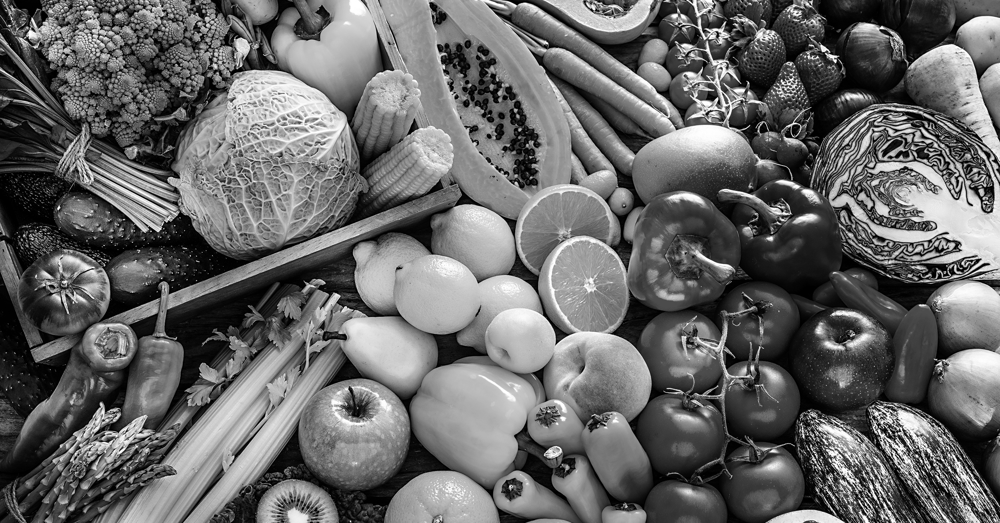

In [54]:
# countur segmentation without using cv2

# read the image
img_gray = img.convert('L')
img_gray 

In [58]:
# convert to hsv using pillow
img_hsv = img.convert('HSV')



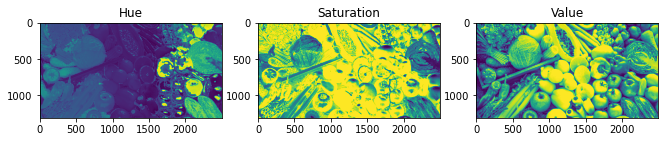

In [62]:
# HSV split. (hue, saturation, value). This is the colour model which human eyes perceive.
h, s, v = img_hsv.split()

# plot the image of each color
plt.figure(figsize=(15,15))
plt.subplot(2,4,1)
plt.imshow(h)
# title of the plot
plt.title('Hue')
plt.subplot(2,4,2)
plt.imshow(s)
plt.title('Saturation')
plt.subplot(2,4,3)
plt.imshow(v)
plt.title('Value')
plt.show()


In [66]:
# threshold the image
new_img = ImgThreshold(img_hsv, 24, 50)


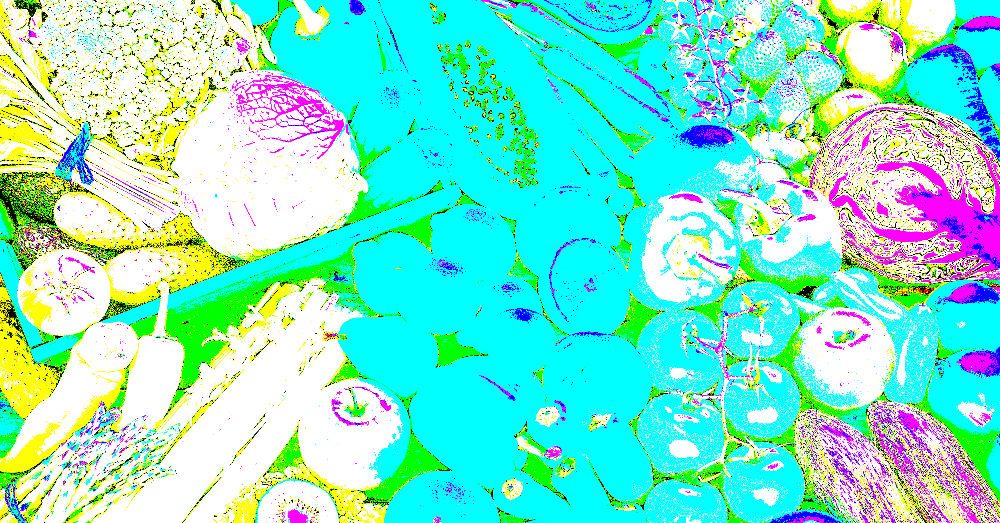

In [67]:
new_img

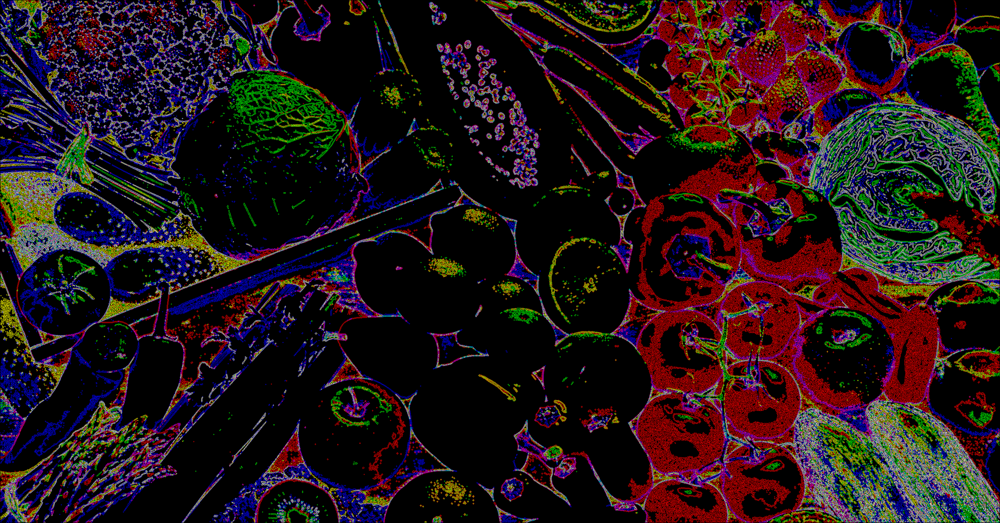

In [70]:
# apply Laplacian filter
new_img = LaplacianFilter(new_img, 24,3)
new_img




In [71]:
# make funtion to get object of same contour
def get_object(img, contour):
    # make a new image
    new_img = Image.new('RGB', (img.width, img.height))
    # get the contour of the image
    contours, hierarchy = cv2.findContours(contour, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # draw the contours
    cv2.drawContours(new_img, contours, -1, (0,255,0), 3)
    return new_img
    

In [72]:
# apply the function
new_img = get_object(img, new_img)

error: OpenCV(4.7.0) :-1: error: (-5:Bad argument) in function 'findContours'
> Overload resolution failed:
>  - image is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'image'
